<a href="https://colab.research.google.com/github/ManuelgUAO/FundamentosIA-2023-03/blob/main/EstabilidadRedElectrica.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

##***Miniproyecto 1 Semestre 2023-03***
$Integrantes:$

**Sergio Andrés León Zambrano** - 2181607
**Jose Manuel Gomez Garcia** - 2190257
**Joshep Peralta Carvajal** - 2200046

Informe: https://uao-my.sharepoint.com/:b:/g/personal/jose_manuel_gomez_uao_edu_co/EfBAI9EneDRCqbwEa3NTmxoBI0qJsx9KTdtaxF5X3wVQPg?e=9xyTaL

**Descripción y análisis:**

Desarrolle dos modelos de machine learning, un regresor lineal multiparamétrico y un regresor polinómico los cuales tengan como objetivo resolver un problema de regresión.

**1.** Encontrar por lo menos tres relaciones entres sus variables por medio del análisis exploratorio de los datos (AED).

**2.** Comparar los dos modelos obtenidos por medio de tres métricas de desempeño.

**3.** Comparar el tiempo de entrenamiento y el tiempo de predicción.

**4.** Plantee una hipótesis y compruébela con sus modelos obtenidos.

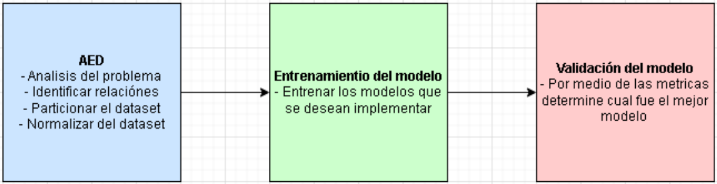



# **DESCRIPCIÓN DEL DATASET**

**Datos simulados de estabilidad de la red eléctrica**

---

El análisis de estabilidad local del sistema en estrella de 4 nodos (el productor de electricidad está en el centro) implementando el concepto de control descentralizado de red inteligente.

Los científicos e ingenieros eléctricos, así como los profesionales de la ciencia de datos, pueden utilizar este conjunto de datos para desarrollar y evaluar modelos predictivos relacionados con la estabilidad de la red eléctrica. Esto podría incluir la detección de condiciones de inestabilidad o la predicción de eventos futuros en una red eléctrica.

**CARACTERISTICAS O ATRIBUTOS**

1. tau[x]: tiempo de reacción del participante (real desde el rango [0,5,10]s).

> **Tau1: el valor para el productor de electricidad**

2. p[x]: potencia nominal consumida(negativa)/producida(positiva)(real). Para consumidores del rango: [-0,5,-2]s^-2

> **p1 = abs(p2 + p3 + p4)**

3. g[x]: coeficiente (gamma) proporcional a la elasticidad precio (real del rango [0.05,1]s^-1).

> **g1 - el valor para el productor de electricidad.**

4. stab: la parte real máxima de la raíz de la ecuación característica (si es positiva, el sistema es linealmente inestable) (real)

5. stabf: la etiqueta de estabilidad del sistema (categórica: estable/inestable)


---

In [ ]:
!rm /content/electrical+grid+stability+simulated+data.zip #eliminar archivo
!rm /content/Data_for_UCI_named.csv #eliminar archivo
!wget "https://archive.ics.uci.edu/static/public/471/electrical+grid+stability+simulated+data.zip" #descargar archivos web
!unzip /content/electrical+grid+stability+simulated+data.zip #descomprimir
!rm /content/electrical+grid+stability+simulated+data.zip #eliminar archivo

rm: cannot remove '/content/electrical+grid+stability+simulated+data.zip': No such file or directory
rm: cannot remove '/content/Data_for_UCI_named.csv': No such file or directory
--2023-09-10 20:29:18--  https://archive.ics.uci.edu/static/public/471/electrical+grid+stability+simulated+data.zip
Resolving archive.ics.uci.edu (archive.ics.uci.edu)... 128.195.10.252
Connecting to archive.ics.uci.edu (archive.ics.uci.edu)|128.195.10.252|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: unspecified
Saving to: ‘electrical+grid+stability+simulated+data.zip’

electrical+grid+sta     [ <=>                ]   2.31M  --.-KB/s    in 0.07s   

2023-09-10 20:29:19 (32.8 MB/s) - ‘electrical+grid+stability+simulated+data.zip’ saved [2418013]

Archive:  /content/electrical+grid+stability+simulated+data.zip
 extracting: Data_for_UCI_named.csv  


# **ANALISIS EXPLORATORIO DE LOS DATOS**

In [ ]:
#Librerias
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import mean_squared_error,mean_absolute_error,r2_score
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression

In [ ]:
df = pd.read_csv('/content/Data_for_UCI_named.csv', encoding= "ISO-8859-1") #ISO-8859-1 codificaciòn de caracteres
df

,tau1,tau2,tau3,tau4,p1,p2,p3,p4,g1,g2,g3,g4,stab,stabf
0,2.959060,3.079885,8.381025,9.780754,3.763085,-0.782604,-1.257395,-1.723086,0.650456,0.859578,0.887445,0.958034,0.055347,unstable
1,9.304097,4.902524,3.047541,1.369357,5.067812,-1.940058,-1.872742,-1.255012,0.413441,0.862414,0.562139,0.781760,-0.005957,stable
2,8.971707,8.848428,3.046479,1.214518,3.405158,-1.207456,-1.277210,-0.920492,0.163041,0.766689,0.839444,0.109853,0.003471,unstable
3,0.716415,7.669600,4.486641,2.340563,3.963791,-1.027473,-1.938944,-0.997374,0.446209,0.976744,0.929381,0.362718,0.028871,unstable
4,3.134112,7.608772,4.943759,9.857573,3.525811,-1.125531,-1.845975,-0.554305,0.797110,0.455450,0.656947,0.820923,0.049860,unstable
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9995,2.930406,9.487627,2.376523,6.187797,3.343416,-0.658054,-1.449106,-1.236256,0.601709,0.779642,0.813512,0.608385,0.023892,unstable
9996,3.392299,1.274827,2.954947,6.894759,4.349512,-1.663661,-0.952437,-1.733414,0.502079,0.567242,0.285880,0.366120,-0.025803,stable
9997,2.364034,2.842030,8.776391,1.008906,4.299976,-1.380719,-0.943884,-1.975373,0.487838,0.986505,0.149286,0.145984,-0.031810,stable
9998,9.631511,3.994398,2.757071,7.821347,2.514755,-0.966330,-0.649915,-0.898510,0.365246,0.587558,0.889118,0.818391,0.037789,unstable


In [ ]:
df.shape #tamaño del dataset

(10000, 14)

In [ ]:
df.info()#infomración del dataset

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Data columns (total 14 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   tau1    10000 non-null  float64
 1   tau2    10000 non-null  float64
 2   tau3    10000 non-null  float64
 3   tau4    10000 non-null  float64
 4   p1      10000 non-null  float64
 5   p2      10000 non-null  float64
 6   p3      10000 non-null  float64
 7   p4      10000 non-null  float64
 8   g1      10000 non-null  float64
 9   g2      10000 non-null  float64
 10  g3      10000 non-null  float64
 11  g4      10000 non-null  float64
 12  stab    10000 non-null  float64
 13  stabf   10000 non-null  object 
dtypes: float64(13), object(1)
memory usage: 1.1+ MB


In [ ]:
df.describe(include='all') # informaciòn estadistica y general del datset

,tau1,tau2,tau3,tau4,p1,p2,p3,p4,g1,g2,g3,g4,stab,stabf
count,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000
unique,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2
top,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,unstable
freq,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6380
mean,5.250000,5.250001,5.250004,5.249997,3.750000,-1.250000,-1.250000,-1.250000,0.525000,0.525000,0.525000,0.525000,0.015731,NaN
std,2.742548,2.742549,2.742549,2.742556,0.752160,0.433035,0.433035,0.433035,0.274256,0.274255,0.274255,0.274255,0.036919,NaN
min,0.500793,0.500141,0.500788,0.500473,1.582590,-1.999891,-1.999945,-1.999926,0.050009,0.050053,0.050054,0.050028,-0.080760,NaN
25%,2.874892,2.875140,2.875522,2.874950,3.218300,-1.624901,-1.625025,-1.624960,0.287521,0.287552,0.287514,0.287494,-0.015557,NaN
50%,5.250004,5.249981,5.249979,5.249734,3.751025,-1.249966,-1.249974,-1.250007,0.525009,0.525003,0.525015,0.525002,0.017142,NaN
75%,7.624690,7.624893,7.624948,7.624838,4.282420,-0.874977,-0.875043,-0.875065,0.762435,0.762490,0.762440,0.762433,0.044878,NaN


In [ ]:
df.isna().sum()#cantidad de valores NAN (Not a Numbe)

tau1     0
tau2     0
tau3     0
tau4     0
p1       0
p2       0
p3       0
p4       0
g1       0
g2       0
g3       0
g4       0
stab     0
stabf    0
dtype: int64

In [ ]:
df.duplicated() #Cantidad de valores duplicados

0       False
1       False
2       False
3       False
4       False
        ...  
9995    False
9996    False
9997    False
9998    False
9999    False
Length: 10000, dtype: bool

In [ ]:
numeric_features= df.select_dtypes(exclude='object') # Creamos un subdataset con los datos numericos
categorical_features=df.select_dtypes(include='object')# Creamos un subdataset con los datos categoricos

In [ ]:
#Ciclo for para imprimir cada una de las columnas o features con sus categorias y sus cantidades
for i in categorical_features.columns:
  print("\n ")
  print('column name  : ', i)
  print(df[i].value_counts())


 
column name  :  stabf
unstable    6380
stable      3620
Name: stabf, dtype: int64


In [ ]:
# Correlación enetre el target y las variables
df.corr()['stab']

<ipython-input-11-d7abcd6c73c4>:2: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  df.corr()['stab']


tau1    0.275761
tau2    0.290975
tau3    0.280700
tau4    0.278576
p1      0.010278
p2      0.006255
p3     -0.003321
p4     -0.020786
g1      0.282774
g2      0.293601
g3      0.308235
g4      0.279214
stab    1.000000
Name: stab, dtype: float64

<ipython-input-12-0a388b92eda4>:4: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  corr = df.corr()


          tau1      tau2      tau3      tau4        p1        p2        p3  \
tau1  1.000000  0.015586 -0.005970 -0.017265  0.027183 -0.015485 -0.015924   
tau2  0.015586  1.000000  0.014273 -0.001965 -0.004769  0.006573  0.007673   
tau3 -0.005970  0.014273  1.000000  0.004354  0.016953 -0.003134 -0.008780   
tau4 -0.017265 -0.001965  0.004354  1.000000 -0.003173  0.010553  0.006169   
p1    0.027183 -0.004769  0.016953 -0.003173  1.000000 -0.573157 -0.584554   
p2   -0.015485  0.006573 -0.003134  0.010553 -0.573157  1.000000  0.002388   
p3   -0.015924  0.007673 -0.008780  0.006169 -0.584554  0.002388  1.000000   
p4   -0.015807 -0.005963 -0.017531 -0.011211 -0.579239 -0.006844  0.012953   
g1    0.010521 -0.001742 -0.011605 -0.004149  0.000721  0.015603 -0.003219   
g2    0.015350  0.015383  0.007671  0.008431  0.015405 -0.018032 -0.011575   
g3   -0.001279  0.016508  0.014702  0.003260  0.001069  0.007555 -0.005897   
g4    0.005494 -0.011764 -0.011497 -0.000491 -0.015451  0.019817

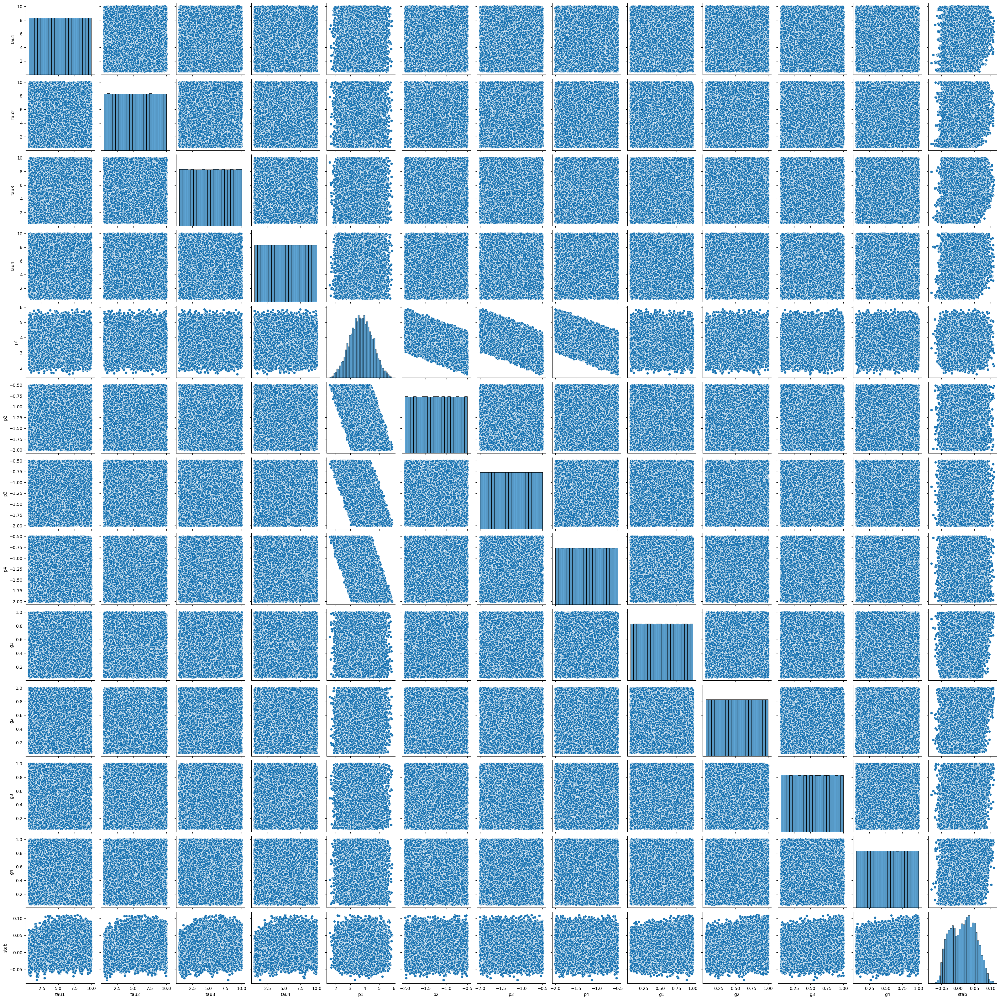

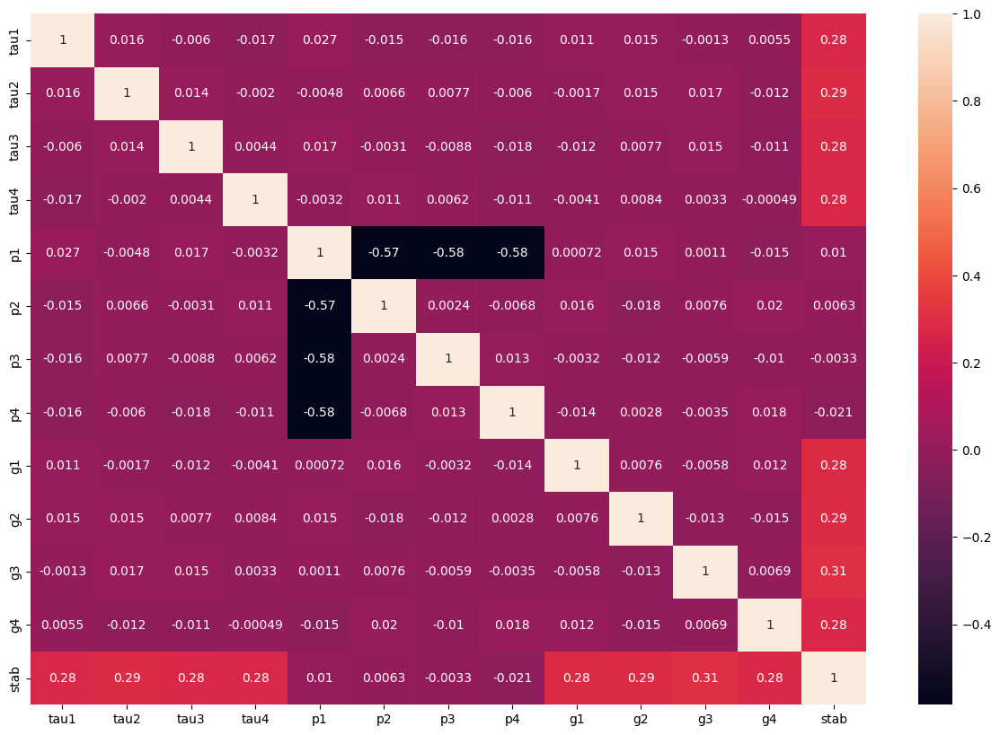

In [ ]:
#Informacion Completa para Interpretacion Inicial
sns.pairplot(df)

corr = df.corr()
print(corr)

plt.figure(figsize=(15,10))
sns.heatmap(corr, annot=True)
plt.show()

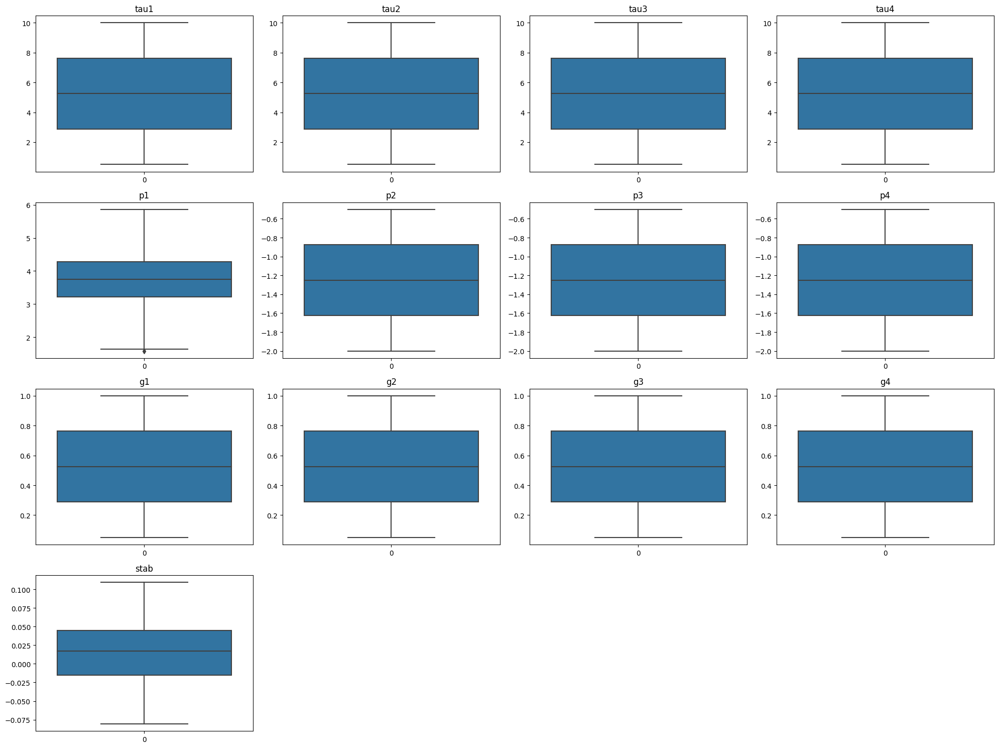

In [ ]:
#Diagrama de cajas para cada variable numerica
n = 1
plt.figure(figsize=(20,15))

for i in numeric_features.columns:
  plt.subplot(4,4,n)
  n=n+1
  sns.boxplot(df[i])
  plt.title(i)
  plt.tight_layout()

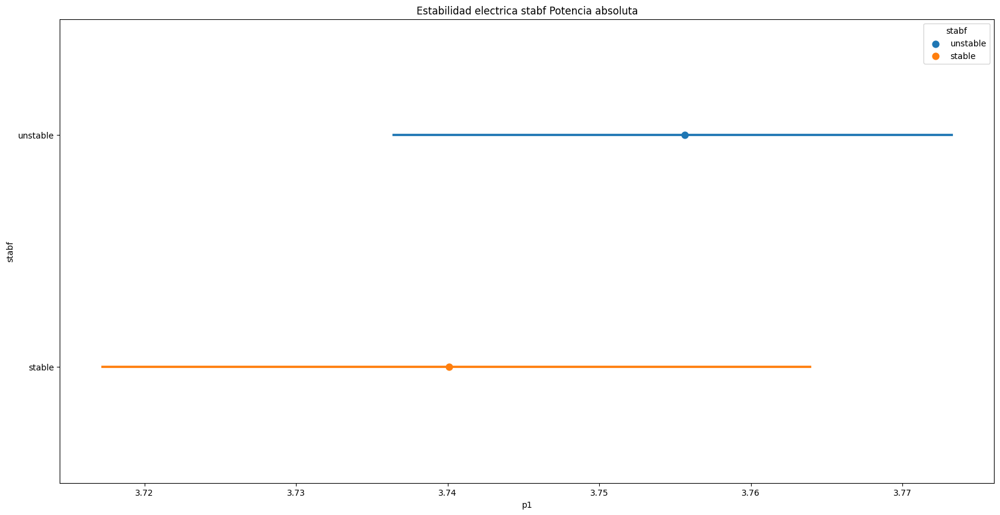

In [ ]:
# Se analiza cada variable categorica(Independiente) vs la variable dependiente o de interes
for i in categorical_features.columns:
  if i == 'p1':
    pass
  else:
    plt.figure(figsize=(20,10))
    sns.pointplot(x=df["p1"],y=df['stabf'],hue=df[i])
    plt.title(f"Estabilidad electrica {i} Potencia absoluta")
  plt.show()

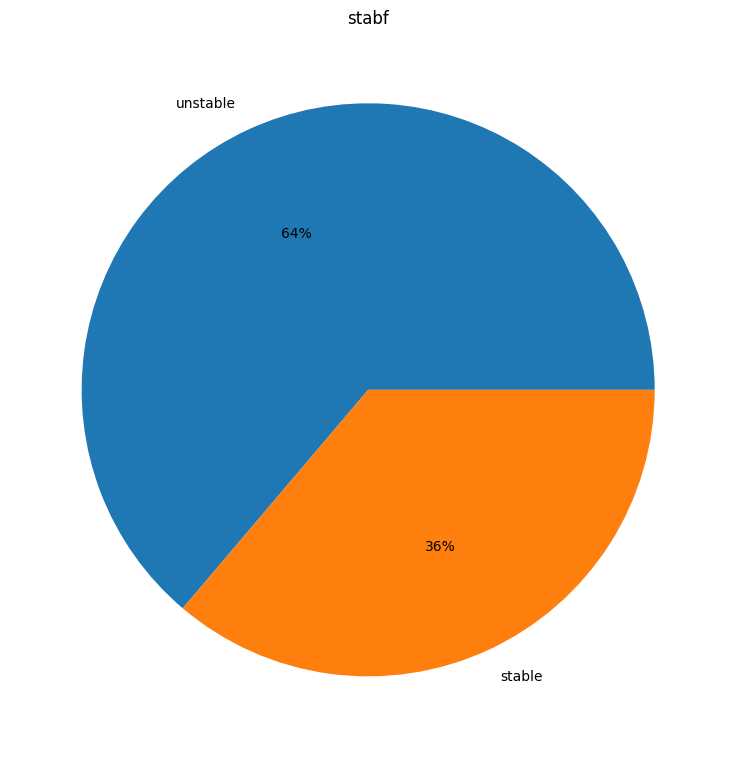

In [ ]:
# diagrama de torta para variables categoricas
n=1
plt.figure(figsize=(20,15))
for i in categorical_features.columns:
  plt.subplot(2,2,n)
  n=n+1
  plt.pie(df[i].value_counts(),labels = df[i].value_counts().keys().tolist(),autopct='%.0f%%')
  plt.title(i)
  plt.tight_layout()

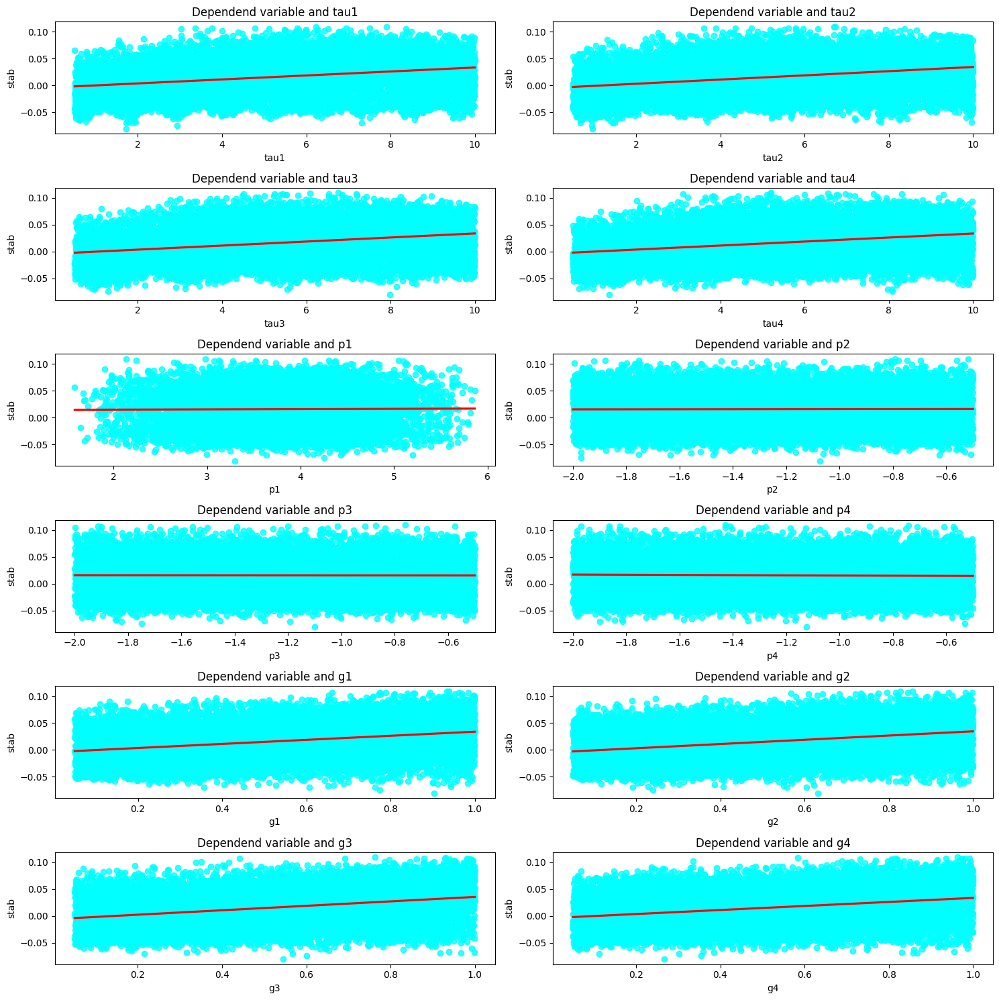

In [ ]:
# Relación entre variables numericas y nuestro target
n=1
plt.figure(figsize=(15,15))
for i in numeric_features.columns:
  if i == 'stab':
    pass
  else:
    plt.subplot(6,2,n)
    n+=1
    sns.regplot(x= df[i],y=  df['stab'],scatter_kws={"color": "cyan"}, line_kws={"color": "red"})
    plt.title(f'Dependend variable and {i}')
    plt.tight_layout()

<ipython-input-18-c8405a7bcbce>:3: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(abs(df.corr()), cmap='coolwarm', annot=True)


<Axes: >

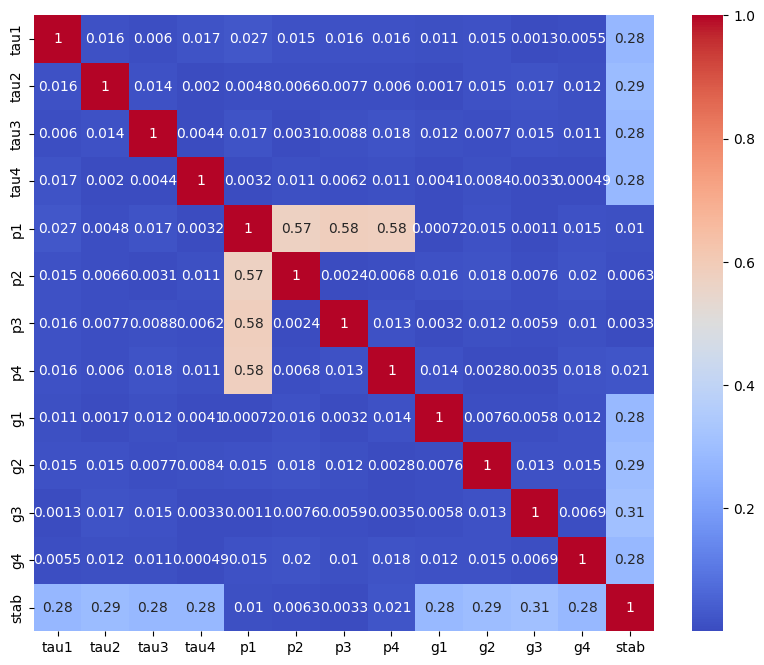

In [ ]:
# Mapa de multicorrelación entre las variables
plt.figure(figsize=(10,8))
sns.heatmap(abs(df.corr()), cmap='coolwarm', annot=True)

### **Normalizacion de datos**

In [ ]:
df['stabf'] = df['stabf'] == 'stable'
df.head(10)

,tau1,tau2,tau3,tau4,p1,p2,p3,p4,g1,g2,g3,g4,stab,stabf
0,2.959060,3.079885,8.381025,9.780754,3.763085,-0.782604,-1.257395,-1.723086,0.650456,0.859578,0.887445,0.958034,0.055347,False
1,9.304097,4.902524,3.047541,1.369357,5.067812,-1.940058,-1.872742,-1.255012,0.413441,0.862414,0.562139,0.781760,-0.005957,True
2,8.971707,8.848428,3.046479,1.214518,3.405158,-1.207456,-1.277210,-0.920492,0.163041,0.766689,0.839444,0.109853,0.003471,False
3,0.716415,7.669600,4.486641,2.340563,3.963791,-1.027473,-1.938944,-0.997374,0.446209,0.976744,0.929381,0.362718,0.028871,False
4,3.134112,7.608772,4.943759,9.857573,3.525811,-1.125531,-1.845975,-0.554305,0.797110,0.455450,0.656947,0.820923,0.049860,False
5,6.999209,9.109247,3.784066,4.267788,4.429669,-1.857139,-0.670397,-1.902133,0.261793,0.077930,0.542884,0.469931,-0.017385,True
6,6.710166,3.765204,6.929314,8.818562,2.397419,-0.614590,-1.208826,-0.574004,0.177890,0.397977,0.402046,0.376630,0.005954,False
7,6.953512,1.379125,5.719400,7.870307,3.224495,-0.748998,-1.186517,-1.288980,0.371385,0.633204,0.732741,0.380544,0.016634,False
8,4.689852,4.007747,1.478573,3.733787,4.041300,-1.410344,-1.238204,-1.392751,0.269708,0.250364,0.164941,0.482439,-0.038677,True
9,9.841496,1.413822,9.769856,7.641616,4.727595,-1.991363,-0.857637,-1.878594,0.376356,0.544415,0.792039,0.116263,0.012383,False


In [ ]:
df['stabf'] = df['stabf'].astype(int)
df.head(10)

,tau1,tau2,tau3,tau4,p1,p2,p3,p4,g1,g2,g3,g4,stab,stabf
0,2.959060,3.079885,8.381025,9.780754,3.763085,-0.782604,-1.257395,-1.723086,0.650456,0.859578,0.887445,0.958034,0.055347,0
1,9.304097,4.902524,3.047541,1.369357,5.067812,-1.940058,-1.872742,-1.255012,0.413441,0.862414,0.562139,0.781760,-0.005957,1
2,8.971707,8.848428,3.046479,1.214518,3.405158,-1.207456,-1.277210,-0.920492,0.163041,0.766689,0.839444,0.109853,0.003471,0
3,0.716415,7.669600,4.486641,2.340563,3.963791,-1.027473,-1.938944,-0.997374,0.446209,0.976744,0.929381,0.362718,0.028871,0
4,3.134112,7.608772,4.943759,9.857573,3.525811,-1.125531,-1.845975,-0.554305,0.797110,0.455450,0.656947,0.820923,0.049860,0
5,6.999209,9.109247,3.784066,4.267788,4.429669,-1.857139,-0.670397,-1.902133,0.261793,0.077930,0.542884,0.469931,-0.017385,1
6,6.710166,3.765204,6.929314,8.818562,2.397419,-0.614590,-1.208826,-0.574004,0.177890,0.397977,0.402046,0.376630,0.005954,0
7,6.953512,1.379125,5.719400,7.870307,3.224495,-0.748998,-1.186517,-1.288980,0.371385,0.633204,0.732741,0.380544,0.016634,0
8,4.689852,4.007747,1.478573,3.733787,4.041300,-1.410344,-1.238204,-1.392751,0.269708,0.250364,0.164941,0.482439,-0.038677,1
9,9.841496,1.413822,9.769856,7.641616,4.727595,-1.991363,-0.857637,-1.878594,0.376356,0.544415,0.792039,0.116263,0.012383,0


In [ ]:
#Normalizacion de todos los datos de la tabla
def normalizar(x,xmax,xmin,ymax,ymin):
    m = (ymax-ymin)/(xmax-xmin)
    b = ymin - m*xmin
    y = m*x + b

    return y

max = np.max(df).values
min = np.min(df).values

df2 = normalizar(df,max,min,1,0)
df2.head(10)

/usr/local/lib/python3.10/dist-packages/numpy/core/fromnumeric.py:84: FutureWarning: In a future version, DataFrame.max(axis=None) will return a scalar max over the entire DataFrame. To retain the old behavior, use 'frame.max(axis=0)' or just 'frame.max()'
  return reduction(axis=axis, out=out, **passkwargs)
/usr/local/lib/python3.10/dist-packages/numpy/core/fromnumeric.py:84: FutureWarning: In a future version, DataFrame.min(axis=None) will return a scalar min over the entire DataFrame. To retain the old behavior, use 'frame.min(axis=0)' or just 'frame.min()'
  return reduction(axis=axis, out=out, **passkwargs)


,tau1,tau2,tau3,tau4,p1,p2,p3,p4,g1,g2,g3,g4,stab,stabf
0,0.258801,0.271561,0.829616,0.976978,0.509244,0.811642,0.495075,0.184572,0.632098,0.852229,0.881531,0.955894,0.715740,0.0
1,0.926793,0.463424,0.268117,0.091471,0.813957,0.039894,0.084809,0.496642,0.382588,0.855215,0.539078,0.770323,0.393359,1.0
2,0.891799,0.878795,0.268005,0.075171,0.425652,0.528367,0.481864,0.719670,0.118990,0.754440,0.831000,0.062980,0.442940,0.0
3,0.022700,0.754704,0.419623,0.193715,0.556118,0.648372,0.040670,0.668412,0.417084,0.975576,0.925677,0.329181,0.576507,0.0
4,0.277230,0.748301,0.467747,0.985065,0.453830,0.582991,0.102655,0.963811,0.786481,0.426782,0.638883,0.811553,0.686885,0.0
5,0.684139,0.906251,0.345657,0.396602,0.664921,0.095182,0.886441,0.065200,0.222947,0.029347,0.518808,0.442048,0.333266,1.0
6,0.653709,0.343702,0.676782,0.875683,0.190299,0.923668,0.527457,0.950677,0.134621,0.366277,0.370546,0.343827,0.455995,0.0
7,0.679328,0.092528,0.549405,0.775856,0.383459,0.834050,0.542331,0.473995,0.338316,0.613913,0.718672,0.347948,0.512161,0.0
8,0.441015,0.369234,0.102939,0.340386,0.574220,0.393088,0.507870,0.404810,0.231280,0.210878,0.120943,0.455217,0.221301,1.0
9,0.983369,0.096180,0.975829,0.751781,0.734501,0.005686,0.761603,0.080893,0.343549,0.520441,0.781097,0.069728,0.489807,0.0


           tau1      tau2      tau3      tau4        p1        p2        p3  \
tau1   1.000000  0.015586 -0.005970 -0.017265  0.027183 -0.015485 -0.015924   
tau2   0.015586  1.000000  0.014273 -0.001965 -0.004769  0.006573  0.007673   
tau3  -0.005970  0.014273  1.000000  0.004354  0.016953 -0.003134 -0.008780   
tau4  -0.017265 -0.001965  0.004354  1.000000 -0.003173  0.010553  0.006169   
p1     0.027183 -0.004769  0.016953 -0.003173  1.000000 -0.573157 -0.584554   
p2    -0.015485  0.006573 -0.003134  0.010553 -0.573157  1.000000  0.002388   
p3    -0.015924  0.007673 -0.008780  0.006169 -0.584554  0.002388  1.000000   
p4    -0.015807 -0.005963 -0.017531 -0.011211 -0.579239 -0.006844  0.012953   
g1     0.010521 -0.001742 -0.011605 -0.004149  0.000721  0.015603 -0.003219   
g2     0.015350  0.015383  0.007671  0.008431  0.015405 -0.018032 -0.011575   
g3    -0.001279  0.016508  0.014702  0.003260  0.001069  0.007555 -0.005897   
g4     0.005494 -0.011764 -0.011497 -0.000491 -0.015

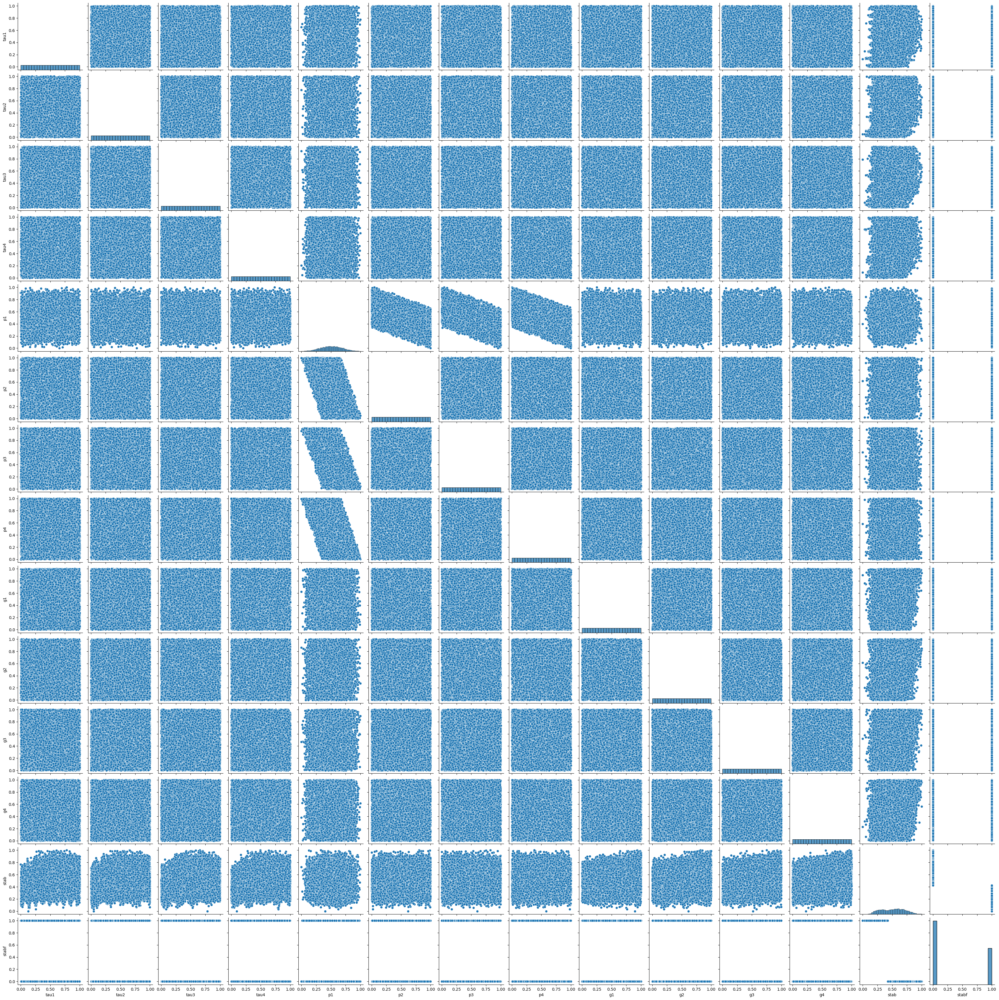

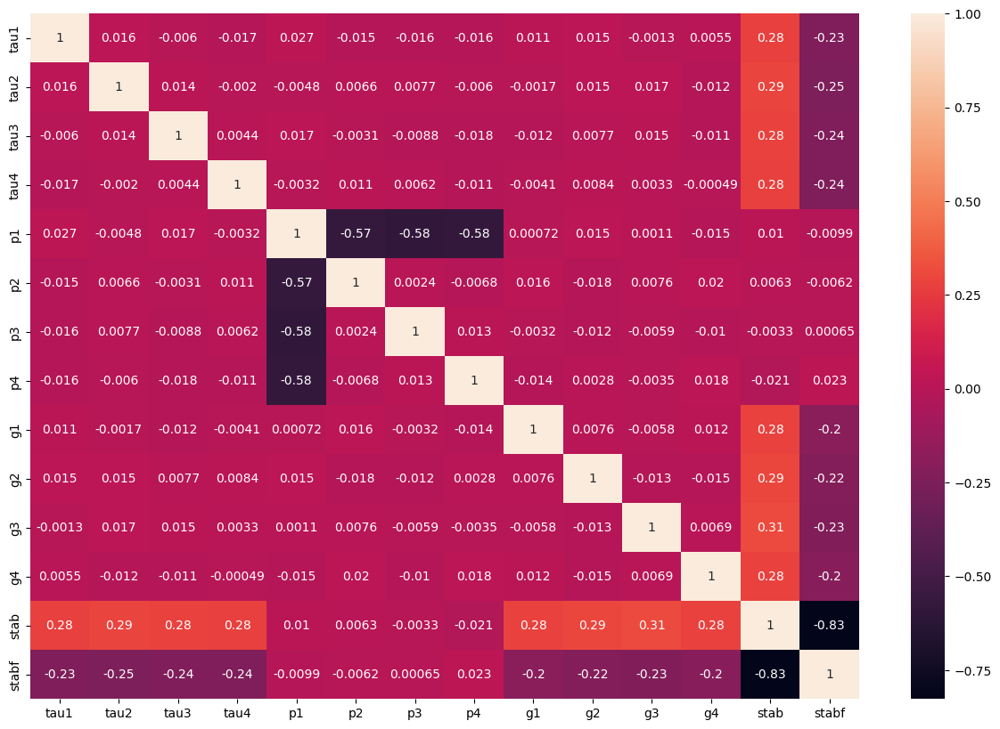

In [ ]:
#Nuevas graficas para Interpretación de los datos
sns.pairplot(df2)

corr = df2.corr()
print(corr)

plt.figure(figsize=(15,10))
sns.heatmap(corr, annot=True)
plt.show()

####**PARTICIÓN DEL DATASET**

In [ ]:
#X = df2.drop(columns=['tau1','tau2','tau3','tau4','p1','p2','p3','p4','stabf','stab']) # Solo g(x)
#X = df2.drop(columns=['p1','p2','p3','p4','g1','g2','g3','g4','stabf','stab']) # Solo tau(x)
X = df2.drop(columns=['p1','p2','p3','p4','stabf','stab']) # Solo tau(x) y g(x)
y = df2['stab']

In [ ]:
X

,tau1,tau2,tau3,tau4,g1,g2,g3,g4
0,0.258801,0.271561,0.829616,0.976978,0.632098,0.852229,0.881531,0.955894
1,0.926793,0.463424,0.268117,0.091471,0.382588,0.855215,0.539078,0.770323
2,0.891799,0.878795,0.268005,0.075171,0.118990,0.754440,0.831000,0.062980
3,0.022700,0.754704,0.419623,0.193715,0.417084,0.975576,0.925677,0.329181
4,0.277230,0.748301,0.467747,0.985065,0.786481,0.426782,0.638883,0.811553
...,...,...,...,...,...,...,...,...
9995,0.255784,0.946081,0.197474,0.598731,0.580781,0.768076,0.803701,0.587804
9996,0.304411,0.081549,0.258369,0.673156,0.475899,0.544472,0.248257,0.332762
9997,0.196158,0.246523,0.871239,0.053525,0.460907,0.985852,0.104463,0.101016
9998,0.961262,0.367828,0.237537,0.770702,0.331853,0.565859,0.883293,0.808887


In [ ]:
X_train,X_test,y_train,y_test = train_test_split(X,y, test_size=0.20,random_state=42)

#**Implementación y selección del modelo**

In [ ]:
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import PolynomialFeatures
from sklearn.pipeline import make_pipeline

El score para el modelo de regresión lineal y los datos de entrenamiento es: 0.647047167422697
El score para el modelo de regresión lineal y los datos de validación es: 0.645228815670585
MAE : 0.09230517905807968
MSE : 0.013306798288808744
RMSE : 0.11535509650123285


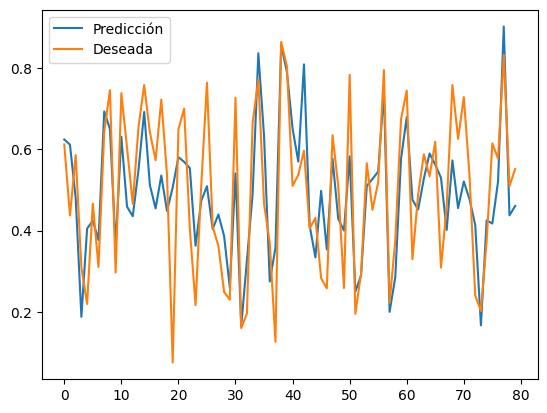

In [ ]:
#Regresión lineal Multiparametrica
from sklearn.linear_model import LinearRegression

Linear = LinearRegression()
Linear.fit(X_train,y_train)

Score_training = Linear.score(X_train,y_train)
print('El score para el modelo de regresión lineal y los datos de entrenamiento es: ' + str(Score_training))
Score_test= Linear.score(X_test,y_test)
print('El score para el modelo de regresión lineal y los datos de validación es: ' + str(Score_test))
#Metricas
y_pred = Linear.predict(X_test)

MAE  = mean_absolute_error(y_test,y_pred)
print("MAE :" , MAE)

MSE  = mean_squared_error(y_test,y_pred)
print("MSE :" , MSE)

RMSE = np.sqrt(MSE)
print("RMSE :" ,RMSE)

plt.plot((y_pred)[:80])
plt.plot((np.array(y_test)[:80]))
plt.legend(["Predicción","Deseada"])
plt.show()

El score para el modelo de regresión lineal y los datos de entrenamiento es: 0.8929010998268123
El score para el modelo de regresión lineal y los datos de validación es: 0.8816399460001457
MAE : 0.05019312647453376
MSE : 0.004439462486237736
RMSE : 0.0666292915033451


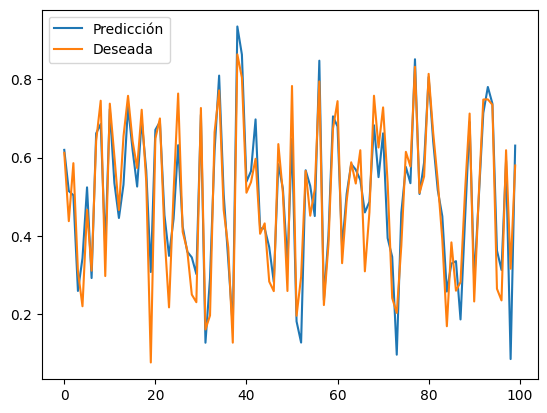

In [ ]:
#Regresión lineal Polinomica
from sklearn.preprocessing import PolynomialFeatures

poly = PolynomialFeatures(2) #creating variable with degree 2
poly_X_train = poly.fit_transform(X_train) # fit the train set
poly_X_test = poly.transform(X_test) #transform the test set

linear_poly = LinearRegression()
linear_poly.fit(poly_X_train,y_train)

Score_training = linear_poly.score(poly_X_train,y_train)
print('El score para el modelo de regresión lineal y los datos de entrenamiento es: ' + str(Score_training))
Score_test= linear_poly.score(poly_X_test,y_test)
print('El score para el modelo de regresión lineal y los datos de validación es: ' + str(Score_test))
#Metricas
y_pred = linear_poly.predict(poly_X_test)

MAE  = mean_absolute_error(y_test,y_pred)
print("MAE :" , MAE)

MSE  = mean_squared_error(y_test,y_pred)
print("MSE :" , MSE)

RMSE = np.sqrt(MSE)
print("RMSE :" ,RMSE)

plt.plot((y_pred)[:100])
plt.plot((np.array(y_test)[:100]))
plt.legend(["Predicción","Deseada"])
plt.show()

In [ ]:
import time

# Medir el tiempo de entrenamiento del modelo multiparametrico
inicio_entrenamiento_multiparametrico = time.time()
Linear.fit(X_train,y_train)
tiempo_entrenamiento_multiparametrico = time.time() - inicio_entrenamiento_multiparametrico

# Medir el tiempo de predicción del modelo multiparametrico
inicio_prediccion_multiparametrico = time.time()
y_pred_multiparametrico = Linear.predict(X_test)
tiempo_prediccion_multiparametrico = time.time() - inicio_prediccion_multiparametrico

# Realiza las mismas mediciones para el modelo polinómico
inicio_entrenamiento_polinomio = time.time()
linear_poly.fit(X_train, y_train)
tiempo_entrenamiento_polinomio = time.time() - inicio_entrenamiento_polinomio

inicio_prediccion_polinomio = time.time()
y_pred_polinomio = linear_poly.predict(X_test)
tiempo_prediccion_polinomio = time.time() - inicio_prediccion_polinomio

print(f"Tiempo de Entrenamiento multiparametrico: {tiempo_entrenamiento_multiparametrico} segundos")
print(f"Tiempo de Predicción multiparametrico: {tiempo_prediccion_multiparametrico} segundos")
print(f"Tiempo de Entrenamiento Polinómico: {tiempo_entrenamiento_polinomio} segundos")
print(f"Tiempo de Predicción Polinómico: {tiempo_prediccion_polinomio} segundos")

Tiempo de Entrenamiento multiparametrico: 0.012552976608276367 segundos
Tiempo de Predicción multiparametrico: 0.006146430969238281 segundos
Tiempo de Entrenamiento Polinómico: 0.010376691818237305 segundos
Tiempo de Predicción Polinómico: 0.004022836685180664 segundos
